# First, try to re-query

In [ ]:
! cd ../

In [1]:
# ! pip install contextily
# ! pip install folium matplotlib mapclassify

In [19]:
from download_images import query_mapillary, thread_routine, runner
import geopandas as gpd
import pandas as pd
import contextily as cx
BASE_DIR = 'data/nyc_metro/'

In [20]:
import os
def get_empty_folders(dirpath):
    l = []
    counter=0
    for root, dirs, files in os.walk(dirpath):
        
        if len(files) == 0:
            l.append(root)
#             print(root)
    
    print(f'Num folders with 0 files: {len(l)}')
    print()
    return l

dirpath = 'data/nyc_metro/'
empty = get_empty_folders(dirpath)

empty_geoids = [s[15:] for s in empty]

Num folders with 0 files: 2940



In [21]:
tract_file_path = '../Tracts/nyc_metro_boundaries/nyc_metro_boundaries.shp'

df = gpd.read_file(tract_file_path)
df.GEOID = df.GEOID.astype(str)
df = df[['GEOID', 'geometry']]
df.head(5)

,GEOID,geometry
0,09003514500,"POLYGON ((-72.56218 41.78077, -72.56122 41.780..."
1,09003514600,"POLYGON ((-72.55995 41.77014, -72.55994 41.770..."
2,09003514700,"POLYGON ((-72.53319 41.77264, -72.53263 41.772..."
3,09003514800,"POLYGON ((-72.51694 41.77688, -72.51671 41.776..."
4,09003514900,"POLYGON ((-72.50908 41.79366, -72.50862 41.793..."


In [22]:
df = df.loc[df.GEOID.isin(empty_geoids)]

In [23]:
df.shape

(2940, 2)

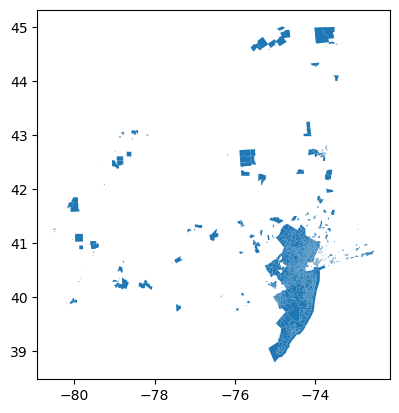

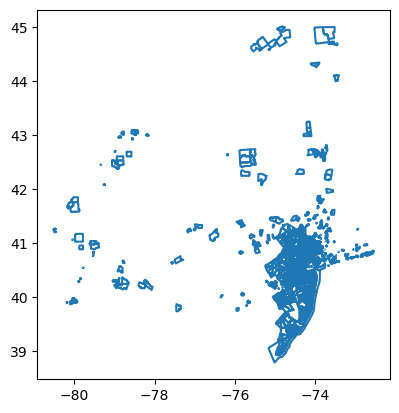

In [24]:
t = df.plot()
# plt.savefig('graph_checkpoints/nyc_metro/map')
t = df.boundary.plot()
# plt.savefig('graph_checkpoints/nyc_metro/boundarymap')

In [25]:
df_wm = df.to_crs(epsg=3857)
df_wm.crs

<Derived Projected CRS: EPSG:3857>
Name: WGS 84 / Pseudo-Mercator
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: World between 85.06°S and 85.06°N.
- bounds: (-180.0, -85.06, 180.0, 85.06)
Coordinate Operation:
- name: Popular Visualisation Pseudo-Mercator
- method: Popular Visualisation Pseudo Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

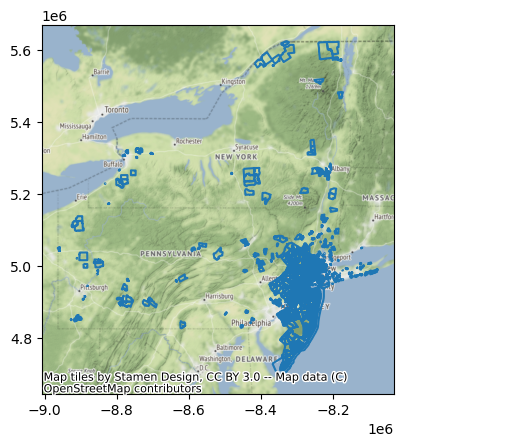

In [26]:
ax = df_wm.boundary.plot()
cx.add_basemap(ax)

In [27]:
df_wm.explore()

In [58]:
minx, miny, maxx, maxy = geom.bounds
bbox = {'west': minx, 'south': miny, 'north': maxy, 'east':maxx}

In [59]:
bbox

{'west': -74.424928,
 'south': 39.362622,
 'north': 39.380716,
 'east': -74.405637}

In [67]:
m = df.loc[df.GEOID == geoid].envelope.explore()

In [69]:
m

In [57]:
geoid = '34001002500'
geom = df.loc[df.GEOID == geoid, 'geometry'].values[0]


bb_data = json.loads(
        mly.images_in_bbox(bbox,
                            image_type='all'))

bb_data

Requesting GET to https://tiles.mapillary.com/maps/vtp/mly1_public/2/14/4804/6239/?access_token=MLY%7C5990009514397174%7Cec6d0114c86e5a941092e3d2731c87a0
Response 200 OK received in 85ms
Requesting GET to https://tiles.mapillary.com/maps/vtp/mly1_public/2/14/4804/6240/?access_token=MLY%7C5990009514397174%7Cec6d0114c86e5a941092e3d2731c87a0
Response 200 OK received in 44ms
Requesting GET to https://tiles.mapillary.com/maps/vtp/mly1_public/2/14/4805/6239/?access_token=MLY%7C5990009514397174%7Cec6d0114c86e5a941092e3d2731c87a0


/home/juro4948/miniconda3/envs/myenv/lib/python3.10/site-packages/mapbox_vector_tile/decoder.py:24: RuntimeWarning: Unexpected end-group tag: Not all data was converted
  self.tile.ParseFromString(pbf_data)


Response 200 OK received in 49ms
Requesting GET to https://tiles.mapillary.com/maps/vtp/mly1_public/2/14/4805/6240/?access_token=MLY%7C5990009514397174%7Cec6d0114c86e5a941092e3d2731c87a0
Response 200 OK received in 51ms


{'type': 'FeatureCollection', 'features': []}

In [56]:
import mapillary.interface as mly
import json

with open('../api_keys/mapillary_key2.txt', 'r') as f:
    key = f.readline()
client_id = key
mly.set_access_token(client_id)

def query_mapillary(geom, imgfilter='all'):
    minx, miny, maxx, maxy = geom.bounds
    bbox = {'west': minx, 'south': miny, 'north': maxy, 'east':maxx}
    # print(bbox)
    # print(f"{bbox['west']}, {bbox['south']},{bbox['east']},{bbox['north']}")

    bb_data = json.loads(
        mly.images_in_bbox(bbox,
                            # max_captured_at="*",
                            # min_captured_at="2012-01-01",
                            image_type=imgfilter,) # compass_angle=(0, 360),
    )
    return bb_data

In [90]:
df.loc[df.GEOID == geoid].envelope.values[0].bounds

(-74.424928, 39.362622, -74.405637, 39.380716)

In [83]:
r#['features'][0]['geometry']#['coordinates']

{'type': 'FeatureCollection', 'features': [{'type': Feature, 'geometry': {'type': Point, 'coordinates': [-74.41173613071442, 39.36635484487246]}, 'properties': {'captured_at': 1575655139073, 'compass_angle': 335.91766357422, 'id': 600136048047493, 'is_pano': False, 'organization_id': 791425358464334, 'sequence_id': '3v3zdn2ifr5lihqkr20y3h'}}, {'type': Feature, 'geometry': {'type': Point, 'coordinates': [-74.41203117370605, 39.366848367622566]}, 'properties': {'captured_at': 1543505244756, 'compass_angle': 332.47280883789, 'id': 344730467072792, 'is_pano': False, 'sequence_id': '9gu25zb82bggx7odnwdn02'}}, {'type': Feature, 'geometry': {'type': Point, 'coordinates': [-74.41980421543121, 39.36351805823534]}, 'properties': {'captured_at': 1575652873147, 'compass_angle': 61.678436279297, 'id': 494529621881889, 'is_pano': False, 'organization_id': 791425358464334, 'sequence_id': 'y1bnicyxc14jbjrrj83g1u'}}, {'type': Feature, 'geometry': {'type': Point, 'coordinates': [-74.42104876041412, 39.3

In [71]:
bb_data = json.loads(
        mly.images_in_bbox(bbox,
                            # max_captured_at="*",
                            # min_captured_at="2012-01-01",
                            image_type='all',
                          closeto={'longitude': -74.417416, 'latitude': 39.364706}) # compass_angle=(0, 360),
    )


InvalidKwargError: InvalidKwargError: The invalid kwarg, ["closeto": {'longitude': -74.417416, 'latitude': 39.364706}] was passed to the function, "image_bbox_check".
A possible list of keys for this function are, max_captured_at, min_captured_at, image_type, compass_angle, organization_id, sequence_id, zoom

In [10]:
# 42071013601, 42021011900, 34019011800, 34019010801

In [35]:
sub = df.loc[df.GEOID.str.contains('3400100')]

In [36]:
sub

,GEOID,geometry
6361,34001000100,"POLYGON ((-74.47673 39.35835, -74.46822 39.360..."
6362,34001001200,"POLYGON ((-74.44584 39.37008, -74.44399 39.373..."
6363,34001001400,"POLYGON ((-74.43982 39.37338, -74.43976 39.373..."
6364,34001000200,"POLYGON ((-74.46781 39.34745, -74.46658 39.348..."
6365,34001000300,"POLYGON ((-74.46086 39.35189, -74.46079 39.352..."
6366,34001000400,"POLYGON ((-74.45913 39.34938, -74.45810 39.349..."
6367,34001001100,"POLYGON ((-74.43805 39.36581, -74.43795 39.365..."
6368,34001001500,"POLYGON ((-74.43170 39.36758, -74.43104 39.367..."
6369,34001002300,"POLYGON ((-74.44659 39.36112, -74.44599 39.362..."
6370,34001002400,"POLYGON ((-74.43881 39.36138, -74.43814 39.361..."


In [37]:
import mapillary.interface as mly
with open('../api_keys/mapillary_key.txt', 'r') as f:
    key = f.readline()
client_id = key
mly.set_access_token(client_id)

runner(sub, BASE_DIR='data/nyc_metro/', res=256)


Region id: 34001000100
Region id: 34001001200
Requesting GET to https://tiles.mapillary.com/maps/vtp/mly1_public/2/14/4802/6240/?access_token=MLY%7C5990009514397174%7Cec6d0114c86e5a941092e3d2731c87a0
Requesting GET to https://tiles.mapillary.com/maps/vtp/mly1_public/2/14/4803/6239/?access_token=MLY%7C5990009514397174%7Cec6d0114c86e5a941092e3d2731c87a0
Region id: 34001001100
Region id: 34001000200
Region id: 34001001500
Region id: 34001000400
Region id: 34001000300
Region id: 34001001400
Requesting GET to https://tiles.mapillary.com/maps/vtp/mly1_public/2/14/4803/6240/?access_token=MLY%7C5990009514397174%7Cec6d0114c86e5a941092e3d2731c87a0
Region id: 34001002300
Region id: 34001002400
Requesting GET to https://tiles.mapillary.com/maps/vtp/mly1_public/2/14/4803/6240/?access_token=MLY%7C5990009514397174%7Cec6d0114c86e5a941092e3d2731c87a0
Requesting GET to https://tiles.mapillary.com/maps/vtp/mly1_public/2/14/4802/6240/?access_token=MLY%7C5990009514397174%7Cec6d0114c86e5a941092e3d2731c87a0


/home/juro4948/miniconda3/envs/myenv/lib/python3.10/site-packages/mapbox_vector_tile/decoder.py:24: RuntimeWarning: Unexpected end-group tag: Not all data was converted
  self.tile.ParseFromString(pbf_data)


Response 200 OK received in 50ms
Requesting GET to https://tiles.mapillary.com/maps/vtp/mly1_public/2/14/4804/6240/?access_token=MLY%7C5990009514397174%7Cec6d0114c86e5a941092e3d2731c87a0
Response 200 OK received in 47ms
Requesting GET to https://tiles.mapillary.com/maps/vtp/mly1_public/2/14/4803/6241/?access_token=MLY%7C5990009514397174%7Cec6d0114c86e5a941092e3d2731c87a0
Response 200 OK received in 43ms
Requesting GET to https://tiles.mapillary.com/maps/vtp/mly1_public/2/14/4803/6241/?access_token=MLY%7C5990009514397174%7Cec6d0114c86e5a941092e3d2731c87a0
Response 200 OK received in 48ms
Requesting GET to https://tiles.mapillary.com/maps/vtp/mly1_public/2/14/4804/6241/?access_token=MLY%7C5990009514397174%7Cec6d0114c86e5a941092e3d2731c87a0
Response 200 OK received in 138ms
No images found in 34001001100.
Region id: 34001000500
Requesting GET to https://tiles.mapillary.com/maps/vtp/mly1_public/2/14/4803/6240/?access_token=MLY%7C5990009514397174%7Cec6d0114c86e5a941092e3d2731c87a0
Response 

In [65]:
import urllib
url = mly.image_thumbnail(image_id='150445480380926', resolution=256)

with urllib.request.urlopen(url) as response, open(filename, 'wb') as out_file:
    data = response.read()

Requesting GET to https://graph.mapillary.com/150445480380926/?fields=thumb_256_url,geometry&access_token=MLY%7C5990009514397174%7Cec6d0114c86e5a941092e3d2731c87a0
Response 200 OK received in 79ms


In [66]:
data

b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xed\x00\x84Photoshop 3.0\x008BIM\x04\x04\x00\x00\x00\x00\x00h\x1c\x02(\x00bFBMD0a000a6e0100006a0400000909000092090000380a00006d0e0000de150000a11600008817000078180000d5250000\x00\xff\xdb\x00C\x00\x06\x04\x05\x06\x05\x04\x06\x06\x05\x06\x07\x07\x06\x08\n\x10\n\n\t\t\n\x14\x0e\x0f\x0c\x10\x17\x14\x18\x18\x17\x14\x16\x16\x1a\x1d%\x1f\x1a\x1b#\x1c\x16\x16 , #&\')*)\x19\x1f-0-(0%()(\xff\xdb\x00C\x01\x07\x07\x07\n\x08\n\x13\n\n\x13(\x1a\x16\x1a((((((((((((((((((((((((((((((((((((((((((((((((((\xff\xc2\x00\x11\x08\x00\xc0\x01\x00\x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1b\x00\x00\x02\x03\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x02\x03\x01\x04\x05\x06\x00\x07\xff\xc4\x00\x18\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\xff\xda\x00\x0c\x03\x01\x00\x02\x10\x03\x10\x00\x00\x01S\n}\xbe\x18"1d\xcfJ0\xe9\x95\x03f,A\xb5\x89Iv\x02\x90/\x1b\x10.\x81\x10\xe1\x13\x0e\

In [62]:
# import random
# geoid = '34001002500'
# geom = df.loc[df.GEOID == geoid, 'geometry'].values[0]

# if os.path.exists(BASE_DIR + str(geoid)):
#     if len(os.listdir(BASE_DIR + str(geoid))) >= 50:
#         # print(geoid)
#         print('already downloaded')
# #     else:
# #         createCleanDir(BASE_DIR + str(geoid))

# # print(f'\n\n\n-----REGION COUNTER {region_counter}------')
# print(f'Region id: {geoid}')
# bb_data = query_mapillary(geom, 'all')

# # now randomly sample num_sample images, query, and save
# # createDir(BASE_DIR + str(geoid))
# imgList = []
# full_image_list = bb_data['features'].copy()

# #         full_image_list = remove_images_not_in_bbox(full_image_list, geom)

# print(len(full_image_list))
# if len(full_image_list) == 0:
#     # region_bow_map[str(geoid)] = None
#     # not_found_counter+=1
#     print(f'No images found in {geoid}.')


# for i in range(0, 50):
#     # print('in loop')
#     filename = BASE_DIR + str(geoid) + "/" + str(i) + ".jpg"

#     sample = random.choice(full_image_list)  # TODO randomly choose 50 all at once  

In [41]:
full_image_list

[]